In [20]:
! pip3 install seaborn

## 1. Data Ingestion

1. Import the necessary libraries:

In [1]:
import os
import pandas as pd


2. Specify the directory where your .xls files are located. In this example, we assume the 'data' directory is in the same directory as your Python script:

In [2]:
data_directory = 'data'

3. Create an empty list to store the dataframes read from each .xls file:

In [3]:
dataframes = []

4. Loop through the files in the 'data' directory, read each .xls file using pd.read_excel(), and append the resulting dataframe to the list:

In [4]:
for filename in os.listdir(data_directory):
    if filename.endswith(".xls"):
        file_path = os.path.join(data_directory, filename)
        df = pd.read_excel(file_path)
        dataframes.append(df)


5. Concatenate the dataframes in the list into a single dataframe if needed. If each `.xls` file represents a different class, you might want to add a class label column to distinguish the classes. Assuming you have a list of class names corresponding to each file, you can do something like this:

In [5]:
class_names = ['cmp', 'cs', 'css', 'ctmsm', 'normal']  # Replace with your actual class names

for i, df in enumerate(dataframes):
    df['class'] = class_names[i]

# Concatenate the dataframes into a single dataframe
combined_df = pd.concat(dataframes, ignore_index=True)


Now, `combined_df` contains all the data from the `.xls` files with an additional 'class' column to distinguish the classes.

You can then proceed with your classification task using `combined_df`. Depending on your specific classification task, you may need to perform data preprocessing, split the data into training and testing sets, and build a machine learning model.

In [6]:
combined_df.head(3)

,Unnamed: 0,Cell Segment Area,Cell Segment Circularity,Cell Segment Coverage,Cell Segment Eccentricity,Cell Segment PL Angle SDI,Cell Segment PL Coherence,Cell Segment PL Entropy,Cell Segment PL Local Coherence,Cell Segment PL Mean,...,Fibre Segment SHG Entropy,Fibre Segment SHG Local Coherence,Fibre Segment SHG Mean,Fibre Segment SHG STD,File,Mean Fibre Length,Mean Fibre Waviness,No. Cells,No. Fibres,class
0,0,27304.970126,0.342573,0.805988,0.822510,0.010651,0.030195,9.524715,0.574723,117.655087,...,10.611572,0.646096,357.870187,375.393209,ctm-E10-12-1-c8,38.306100,0.913512,24,274,cmp
1,1,25788.174912,0.260420,0.570202,0.810084,0.026456,0.033618,8.120737,0.521951,46.430828,...,11.082612,0.606293,325.456947,342.334492,ctm-E239-15-1a-c15,26.287601,0.930829,34,625,cmp
2,2,171952.800250,0.105580,0.722950,0.608331,0.007851,0.028218,9.330521,0.591412,84.624452,...,11.262352,0.702718,587.889284,566.580794,ctm-E48-12-1e2-c9,30.351248,0.925518,12,527,cmp


## 2. General analysis

In [7]:
# Display basic information about the dataset
print(combined_df.info())

# Display the first few rows of the dataset
print(combined_df.head())

# Summary statistics of numerical columns
print(combined_df.describe())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1384 entries, 0 to 1383
Data columns (total 32 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   Unnamed: 0                         1384 non-null   int64  
 1   Cell Segment Area                  1384 non-null   float64
 2   Cell Segment Circularity           1384 non-null   float64
 3   Cell Segment Coverage              1384 non-null   float64
 4   Cell Segment Eccentricity          1384 non-null   float64
 5   Cell Segment PL Angle SDI          1384 non-null   float64
 6   Cell Segment PL Coherence          1384 non-null   float64
 7   Cell Segment PL Entropy            1384 non-null   float64
 8   Cell Segment PL Local Coherence    1384 non-null   float64
 9   Cell Segment PL Mean               1384 non-null   float64
 10  Cell Segment PL STD                1384 non-null   float64
 11  Fibre Angle SDI                    1384 non-null   float

#### 1.1 Comentario:
O ChatGPT não tem acesso às colunas existentes no dataset. Por isso, não procura eliminar (e nem orienta a tal) colunas que não contém dados pertinentes à tarefa, como 'Unnamed: 0' (índice carregado do .xls) ou 'File' (nome do arquivo de imagem).

2. **Data Cleaning:**

   Check for missing values and handle them if necessary:

In [8]:
# Check for missing values
print(combined_df.isnull().sum())

# Handle missing values if needed (e.g., using fillna() or dropna())

Unnamed: 0                           0
Cell Segment Area                    0
Cell Segment Circularity             0
Cell Segment Coverage                0
Cell Segment Eccentricity            0
Cell Segment PL Angle SDI            0
Cell Segment PL Coherence            0
Cell Segment PL Entropy              0
Cell Segment PL Local Coherence      0
Cell Segment PL Mean                 0
Cell Segment PL STD                  0
Fibre Angle SDI                      0
Fibre Network Connectivity           0
Fibre Network Cross-Link Density     0
Fibre Network Degree                 0
Fibre Network Eigenvalue             0
Fibre Segment Area                   0
Fibre Segment Circularity            0
Fibre Segment Coverage               0
Fibre Segment Eccentricity           0
Fibre Segment SHG Angle SDI          0
Fibre Segment SHG Coherence          0
Fibre Segment SHG Entropy            0
Fibre Segment SHG Local Coherence    0
Fibre Segment SHG Mean               0
Fibre Segment SHG STD    

#### 2.1 Comentário

O ChatGPT optou por ser bem geral nessa sugestão de data cleaning, apenas mostrou a soma dos nulos para cada coluna. Entretanto, a ferramenta não explicou quais são as consequências de dados nulos e nem entrou em detalhes sobre como abordar esse problema, apenas mencionou os métodos que podem ser utilizados. Entretanto, caso esses pontos fossem enfatizados num outro prompt, é de se esperar que o ChatGPT elaboraria mais sobre essa etapa.

3. **Data Visualization:**

   Visualize your data to better understand its distribution and characteristics. You can use libraries like `matplotlib` or `seaborn` for this purpose:
   ```python
   import matplotlib.pyplot as plt
   import seaborn as sns

   # Example: Plot a histogram of a numerical feature
   plt.figure(figsize=(8, 6))
   sns.histplot(data=combined_df, x='numeric_feature', bins=20, kde=True)
   plt.title('Distribution of Numeric Feature')
   plt.show()

   # Explore relationships between variables (e.g., pair plots or correlation matrix)
   sns.pairplot(combined_df, hue='class')```

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


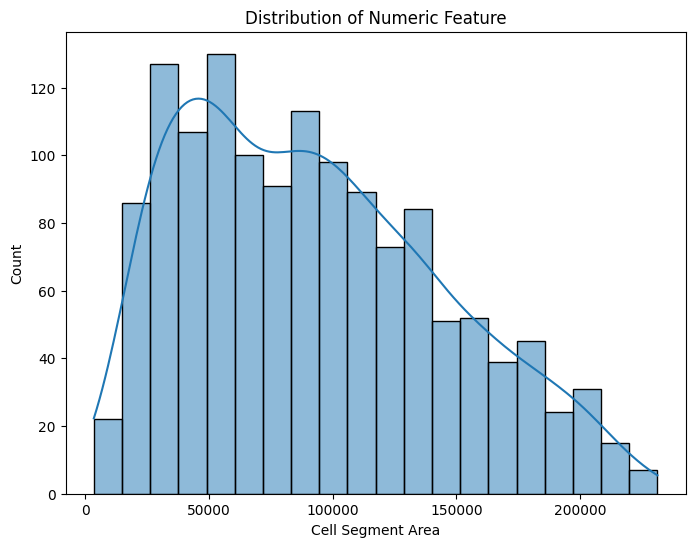

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: 

In [9]:
import matplotlib.pyplot as plt
import seaborn as sns

# Example: Plot a histogram of a numerical feature
plt.figure(figsize=(8, 6))
sns.histplot(data=combined_df, x='Cell Segment Area', bins=20, kde=True)
plt.title('Distribution of Numeric Feature')
plt.show()

# Explore relationships between variables (e.g., pair plots or correlation matrix)
sns.pairplot(combined_df, hue='class')

3.1 Comentário

Embora o pairplot tenha sido feito corretamente, é difícil extrair informações e traçar conclusões por 2 motivos:
São muitas features e apenas uma imagem para todos os pares fez com que os gráficos ficassem bem pequenos
Pela imagem, não está fácil de discernir se há transparência entre os pontos - então talvez um ponto esteja cobrindo outro nas visualizações. Isso acaba tornando difícil de visualizar o agrupamento dos pontos para as diferentes classes.

4. **Class Distribution:**

   Check the distribution of classes in your dataset to see if it's balanced or imbalanced:

In [10]:
class_distribution = combined_df['class'].value_counts()
print(class_distribution)

class
normal    438
cs        347
cmp       290
ctmsm     166
css       143
Name: count, dtype: int64


5. **Feature Analysis:**

   Explore the characteristics of your features. Depending on your data, you may want to analyze categorical features, numerical features, or both.

5.1 Comentário

Nessa seção e na seguinte, a ferramenta apenas descreveu brevemente as etapas, sem fornecer nenhum trecho de código ou elaborar a fundo sua importância. Parece que a ferramenta espera que o usuário já saiba a fundo como realizar as tarefas.

6. **Data Preprocessing:**

   If your dataset requires preprocessing (e.g., feature scaling, encoding categorical variables), perform the necessary steps to prepare it for modeling.

6.1 Comentário

Assim como na seção anterior, a ferramenta apenas delineou brevemente o tópico. Pela sugestão " If your dataset requires preprocessing [...] perform the necessary steps to prepare it for modeling.", é possível observar que a ferramenta espera que o usuário saiba tanto reconhecer se a base necessita de processamento quanto os passos necessários de processamento.

7. **Correlation Analysis:**

   If your dataset contains numerical features, you can calculate and visualize correlations:
   ```python
   # Calculate and visualize the correlation matrix
   correlation_matrix = combined_df.corr()
   sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
   plt.title('Correlation Matrix')
   plt.show()```

### Comentário: 
O código acima não funcionou devido à presença da coluna não-numérica 'File'. Dropamos para que o próximo passo fosse executado.


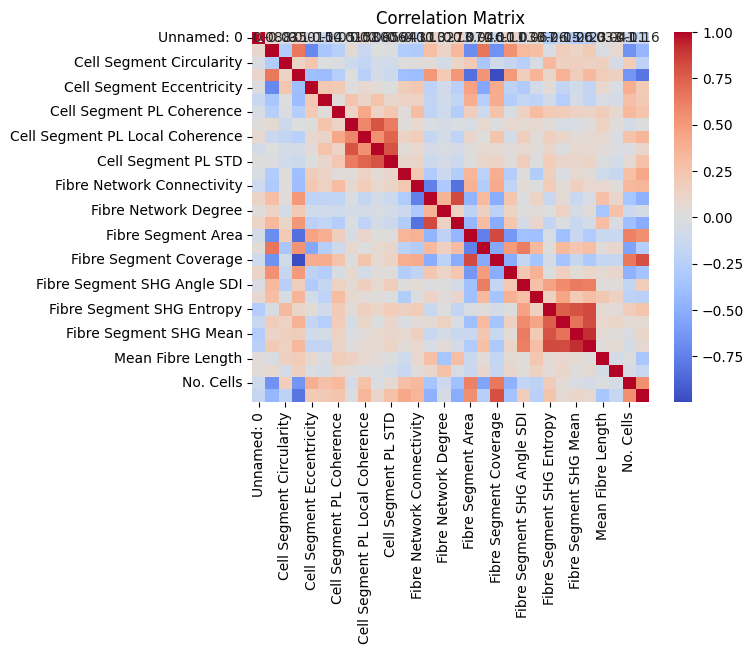

In [11]:
# Calculate and visualize the correlation matrix
combined_df1 = combined_df.drop(['File', 'class'], axis=1) # drop file col

correlation_matrix = combined_df1.corr()
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Matrix')
plt.show()















   ```python
   
   ```

8. **Outlier Detection:**

   Identify and handle outliers if they exist in your data. You can use various methods like the IQR method or visualization techniques to detect outliers.

9. **Data Summary:**

   Summarize your findings and insights from the data analysis. This will help you understand the characteristics of your dataset and inform your decisions for the classification task.

10. **Further Analysis:**

    Depending on the specific requirements of your classification task, you may need to perform additional analysis or preprocessing steps, such as feature selection or engineering.

Remember that the analysis will vary depending on the nature of your dataset and the goals of your classification task. The above steps provide a general framework for exploring and understanding your data before moving on to modeling.